In [1]:
from IPython.display import HTML, Image

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Toggle Code"></form>''')

In [1]:
%run /Users/denis/Documents/Projects/scripts/init.ipy
os.chdir('/Users/denis/Documents/Projects/macacus-virus-analysis')

In [2]:
##### Read Data #####
### Ebola ###
# Expression
ebolaExpressionDataframe = pd.read_table('ebola-makona-analysis/f06-normalized_expression.dir/ebola_pbmc-gene_vst.txt', index_col='gene_symbol')

# Annotation
ebolaAnnotationDataframe = pd.read_table('ebola-makona-analysis/f04-annotation.dir/ebola_pbmc-sample_annotations.txt', index_col='sample_name').replace('ND', np.nan)

# Differential expression
ebolaCdDataframe = pd.read_table('ebola-makona-analysis/f07-differential_expression.dir/cd/ebola_pbmc-gene_vst_differential_expression.txt', index_col='gene_symbol').fillna(0)

# Enrichr links
ebolaEnrichrLinkDataframe = pd.read_table('ebola-makona-analysis/f08-enrichr.dir/ebola_pbmc-gene_vst_enrichr_links.txt')

# Enrichr results
ebolaEnrichrResultDataframe = pd.read_table('ebola-makona-analysis/f08-enrichr.dir/ebola_pbmc-gene_vst_enrichr_results.txt')

# Drug links
ebolaDrugLinkDataframe = pd.read_table('ebola-makona-analysis/f09-l1000cds2.dir/ebola_pbmc-gene_vst_l1000cds2_links.txt')

# Drug results
ebolaDrugSignatureDataframe = pd.read_table('ebola-makona-analysis/f09-l1000cds2.dir/ebola_pbmc-gene_vst_l1000cds2_signatures.txt', usecols=['pert_desc', 'pubchem_id', 'aggravate', 'timepoint']).dropna()

# Network
ebolaNetworkFile = 'ebola-makona-analysis/f10-clinical_association.dir/cytoscape/spearman_network.xgmml'

# Parameter enrichment
ebolaParameterEnrichmentDataframe = pd.read_table('ebola-makona-analysis/f11-clinical_association_enrichment.dir/ebola_pmbc-gene_clinical_correlations_spearman_enrichr_links.txt')

### Yellow Fever ###
# Expression
yfvExpressionDataframe = pd.read_table('yfv-analysis/f2-expression.dir/yfv-gene_expression.txt', index_col='gene_symbol')

# Annotation
yfvAnnotationDataframe = pd.read_table('yfv-analysis/f1-annotation.dir/yfv-sample_annotations.txt', index_col='Sample_geo_accession').replace('ND', np.nan)

# Drop samples
yfvExpressionDataframe.drop(yfvAnnotationDataframe.index[yfvAnnotationDataframe['treatment']=='17D-vaccinated'], axis=1, inplace=True)

# Differential expression
yfvCdDataframe = pd.read_table('yfv-analysis/f3-differential_expression.dir/cd/yfv-gene_differential_expression.txt', index_col='gene_symbol').fillna(0)

# Enrichr links
yfvEnrichrLinkDataframe = pd.read_table('yfv-analysis/f4-enrichr.dir/yfv-gene_enrichr_links.txt')

# Drug links
yfvDrugLinkDataframe = pd.read_table('yfv-analysis/f5-l1000cds2.dir/yfv-gene_l1000cds2_links.txt')

# Drug results
yfvDrugSignatureDataframe = pd.read_table('yfv-analysis/f5-l1000cds2.dir/yfv-gene_l1000cds2_signatures.txt', usecols=['pert_desc', 'pubchem_id', 'aggravate']).dropna()

# Network
yfvNetworkFile = 'yfv-analysis/f6-clinical_association.dir/cytoscape/yfv-network.xgmml'

# Parameter enrichment
yfvParameterEnrichmentDataframe = pd.read_table('yfv-analysis/f7-clinical_association_enrichment.dir/yfv-gene_clinical_correlations_spearman_enrichr_links.txt')

# Computational analysis of gene expression signatures of peripheral blood mononucleated cells (PBMCs) following infection by different viruses in Rhesus macaque

## Overview
### Data
The following report contains analyses of two datasets generated by gene expression profiling of peripheral blood mononucleated cells (PBMCs) in the Rhesus macaque (*Macaca mulatta*) following viral infection.  Data was generated by the Messaoudi lab.

Datasets were generated by infecting macaques with two viruses:
- Ebola virus (*Zaire ebolavirus*), Makona strain.  The data was generated by RNA-seq and consists of 30 samples generated by infection of 10 different animals, extracted before infection and at multiple timepoints between 1 and 6 days post infection (DPI).
- Yellow fever virus (gen. *Flavivirus*).  The data was generated by microarray and consists of 12 samples generated by infection of 3 animals by two virus strains, wild-type Yellow Fever Virus (wtYFV) and 17D-mutated virus, extracted before infection and at 3 days post infection.  Data is publicly available on GEO under the accession GSE51972.

### Aims
The overarching goal of the report is to analyze the differential gene expression signatures induced by infection of Ebola and YFV in Macaque PBMCs.

The report is divided in two sections, one for each virus type.  Each section addresses the following specific aims:
1.	Investigate sample separation in an unbiased manner by visualizing the dataset using Principal Components Analysis (PCA) and interactive heatmaps.
2.	Calculate differential gene expression signatures generated by virus infection, comparing gene expression levels at different timepoints to the pre-infection levels.
3.	Characterize the gene expression signatures by calculating the enrichment of relevant biological pathways and terms.
4.	Identify small molecules which reproducibly mimic or reverse the observed gene expression signatures, by querying a small molecule perturbation database.
5.	Investigate the impact of viral infection on clinical blood parameters, by investigating their variation over time and their correlation to gene expression levels.

# Results
## 1. Ebola Makona
### Overview of the dataset
The Ebola Makona infection dataset consists of 30 RNA-seq samples generated by infection of 10 animals followed by PBMC sampling at multiple timepoints between 0 and 6 DPI.  The samples are divided in the following timepoints: 10 samples before infection (day 0); 5 from day 1; 4 from day 2; 3 from day 3; 2 for day 4; 2 for day 5; 4 from day 6.

### 1.1 PCA Analysis
To visualize the dataset and assess separation of samples, a PCA analysis was performed on the dataset.

In [4]:
ebolaAnnotationDataframe['annotation'] = ['Animal ID: %(animal_ID)s<br>Viral Loads:%(Viral_Loads)s<br>Day: %(day)s' % locals() for animal_ID, Viral_Loads, day in ebolaAnnotationDataframe[['animal_ID', 'Viral Loads', 'day']].as_matrix()]
plot3DPCA(ebolaExpressionDataframe, ebolaAnnotationDataframe, 'day', 'annotation', topVarianceGenes=5000, title='PCA Analysis of Ebola Dataset<br>Colored by Timepoint (DPI)', colors=['#fed976','#feb24c','#fd8d3c','#fc4e2a','#e31a1c','#bd0026','#800026'])

**Figure 1 | PCA analysis of the Ebola RNA-seq dataset.** The plot displays a projection of the gene expression dataset in a 3-dimensional plane, where each point represents a different sample. Axes recapitulate fractions of the variance observed in the dataset, and account for independent sources of variation in the data. Point colors correspond to different timepoints of infection, measured in DPI.  Principal Component 1 (PC1), which accounts for the largest fraction of variance in the dataset, shows a strong association to the sample’s timepoint in DPI.

### 1.2 Interactive heatmap
To interactively visualize the dataset, an interactive heatmap was generated using Clustergrammer (http://amp.pharm.mssm.edu/clustergrammer/).


In [5]:
plotClustergrammerWidget(ebolaExpressionDataframe, ebolaAnnotationDataframe, ['day'], zscore='columns')

Widget Javascript not detected.  It may not be installed or enabled properly.


**Figure 2 | Interactive visualization of the expression levels of the most variable genes.**  The tool allows to interactively explore the expression of the top 1000 most variably expressed genes (displayed on rows) across the 30 RNA-seq samples (displayed on columns).  Values represent gene expression levels, transformed by Z-scores on columns.  Color bars above the columns show the sample’s timepoint in DPI.  The tool allows to identify clusters of coexpressed genes, and to calculate enriched biological terms using Enrichr (Chen et al., 2013).

### 1.3 Differential gene expression analysis
To investigate the effect of viral infection on the transcriptome of PBMCs, differential gene expression signatures were calculated by comparing gene expression levels at different timepoints to the one at the zero timepoint using the Characteristic Direction method (Clark et al., 2014).  The method requires a minimum of 3 samples per timepoint; as the day 4 and 5 timepoints have 2 samples each, they were merged in a single ‘day4-5’ timepoint.


In [6]:
plotClustergrammerWidget(ebolaCdDataframe, topVarianceGenes=1000)

Widget Javascript not detected.  It may not be installed or enabled properly.


**Figure 3 | Interactive visualization of the differential expression levels of the most variably differentially expressed genes.**  Rows represent genes, columns represent differential gene expression signatures calculated by comparing samples of the corresponding timepoint to the 0 timepoint, values represent differential expression estimated by Characteristic Direction (CD).  The heatmap reveals the presence of two main clusters of genes, distinguished by patterns of overexpression in early timepoints (days 1 and 2) or in later timepoints (days 3 to 6).

### 1.4 Enrichment analysis
To investigate the biological pathways associated to the differentially expressed genes, an enrichment analysis was performed using Enrichr.

#### 1.4.1 Early and late genesets
The first section of the analysis aims to broadly characterize the differential gene expression patterns across timepoints by calculating the enrichment in the two clusters of genes identified in Figure 3, labeled early and late genesets.


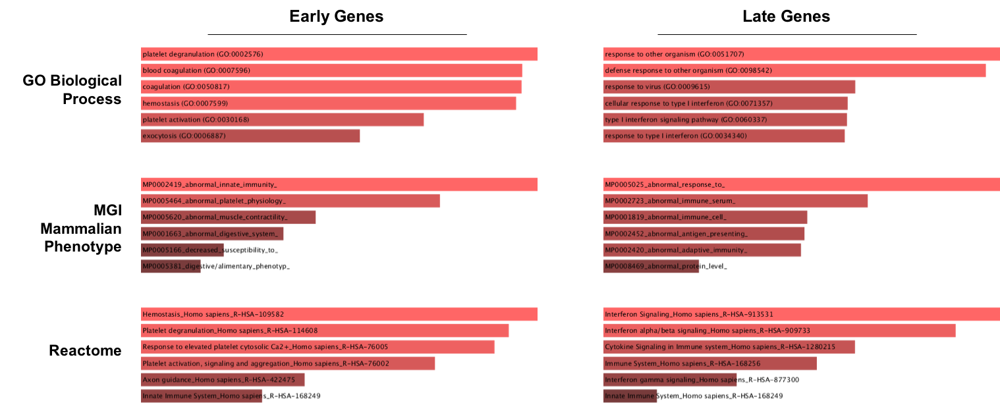

In [25]:
Image('../reports/jupyter-reports/macacus-virus-analysis/ebola_enrichment.png')

**Figure 4 | Selected enrichment results for the early and late genesets induced by Ebola infection.**  The figure displays some of the terms which are most significantly associated to the genesets, as ranked by Enrichr.

#### 1.4.2 Timepoint analysis
The second section of the analysis aims to characterize the enrichment of gene expression signatures for each individual timepoint.  For each signature, the top 500 most overexpressed and underexpressed genes were analyzed.


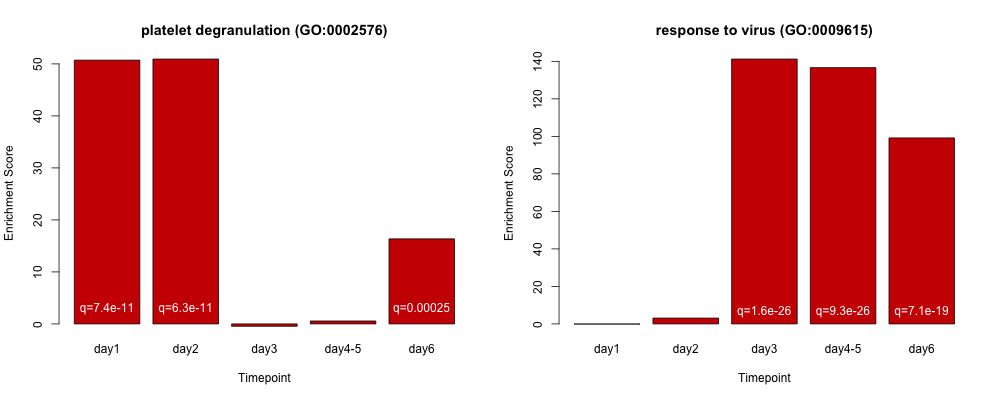

In [8]:
%%R -i ebolaEnrichrResultDataframe -h 400 -w 1000

# Get subset
ebolaEnrichrResultDataframe <- ebolaEnrichrResultDataframe[ebolaEnrichrResultDataframe$geneset=='upregulated',]

# Select genesets
genesets <- c('platelet degranulation (GO:0002576)', 'response to virus (GO:0009615)')

# Set grid
par(mfrow=c(1, length(genesets)))

# Loop through selected genesets
for (geneset in genesets) {
    
    # Get subset
    plotDataframe <- ebolaEnrichrResultDataframe[ebolaEnrichrResultDataframe$term_name == geneset,]
    
    # Get FDR label
    signifLabels <- sapply(plotDataframe$FDR, function(x) ifelse(x<0.05, paste0('q=', format(x, digits=2)), ''))

    # Add x labels
    xLabels <- paste(plotDataframe$timepoint, signifLabels, sep='\n')
        
    # Plot
    bp <- barplot(plotDataframe$combined_score, names.arg=plotDataframe$timepoint,
                  col='red3', main=geneset, xlab='Timepoint', ylab='Enrichment Score')
        
    # Add text
    text(x=bp, y=1, signifLabels, pos=3, col='white')
}

**Figure 5 | Enrichment across the upregulated genesets of separate timepoints for selected terms.**  The plot displays the combined enrichment score, as calculated by Enrichr, of two of the most significantly associated pathways.

Full enrichment results are available below:


In [9]:
# Add link
ebolaEnrichrLinkDataframe['link'] = ['<a href="%(x)s">%(x)s</a>' %locals() for x in ebolaEnrichrLinkDataframe['URL']]

# Cast
linkDataframe = ebolaEnrichrLinkDataframe.pivot(index='timepoint', columns='geneset', values='link')

# Display
pd.set_option('display.max_colwidth', -1)
HTML(linkDataframe.to_html(escape=False))

geneset,downregulated,upregulated
timepoint,,
day1,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anw2,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anvz
day2,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anw8,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anw5
day3,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anwe,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anwb
day4-5,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anwk,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anwh
day6,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anwq,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anwn


### 1.5 Small molecule profiling
To identify small molecules which can mimic or reverse the observed differential gene expression signatures when used for treatment on cell lines, the L1000 small molecule perturbation database was queried using the L1000CDS<sup>2</sup> tool (Duan et al., 2016).

For each timepoint, the top 50 most similar and 50 most opposite signatures were extracted, and the names of the small molecules which generated them were extracted.  For each timepoint, the number of times each small molecule appears within the top 50 signatures was calculated and plotted below.

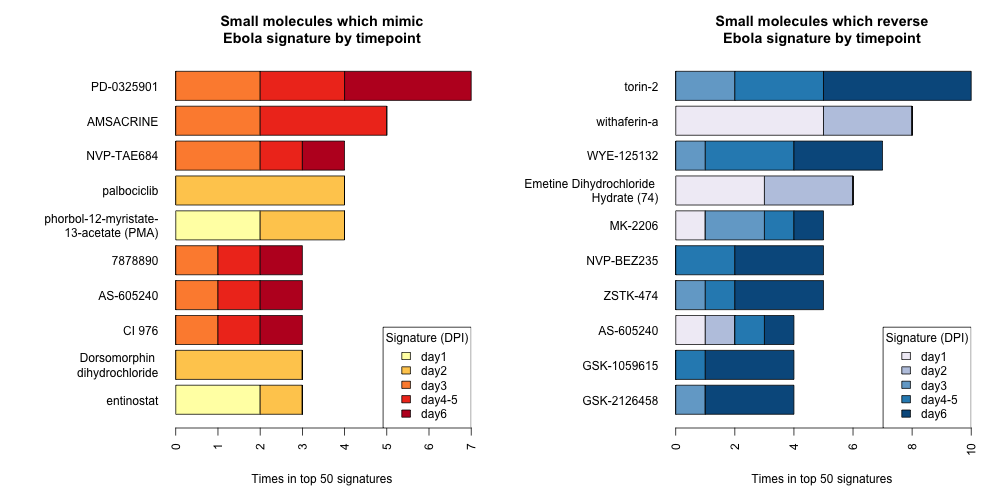

In [10]:
%%R -i ebolaDrugSignatureDataframe -h 500 -w 1000

# Set parameters
par(mar=c(5,12,4,2), mfrow=c(1,2))

# Fix names
ebolaDrugSignatureDataframe$pert_desc <- gsub('myristate-', 'myristate-\n', ebolaDrugSignatureDataframe$pert_desc)
ebolaDrugSignatureDataframe$pert_desc <- gsub('Hydrate', '\nHydrate', ebolaDrugSignatureDataframe$pert_desc)
ebolaDrugSignatureDataframe$pert_desc <- gsub('dihydrochloride', '\ndihydrochloride', ebolaDrugSignatureDataframe$pert_desc)

# Plot
ebolaMimicDrugCounts <- getL1000CDS2Counts(ebolaDrugSignatureDataframe, aggravate=TRUE, group='timepoint', legendTitle='Signature (DPI)', main='Small molecules which mimic\nEbola signature by timepoint')
ebolaMimicDrugCounts <- getL1000CDS2Counts(ebolaDrugSignatureDataframe, aggravate=FALSE, group='timepoint', legendTitle='Signature (DPI)', main='Small molecules which reverse\nEbola signature by timepoint')

**Figure 6 | Summary of the most relevant small molecules which mimic or reverse Ebola infection signatures.**  The barchart represents the number of times each molecule appears within the top 50 most similar or opposite signatures.  Colors represent different timepoints.  Some of the identified small molecules have been reported to be involved in immune modulation and inhibition of viral replication, such as withaferin-A (Mohan et al., 2004) and emetine (Chaves Valadão et al., 2015).

Full results are available below:

In [11]:
# Add link
ebolaDrugLinkDataframe['link'] = ['<a href="%(x)s">http://amp.pharm.mssm.edu/L1000CDS2/...</a>' % locals() for x in ebolaDrugLinkDataframe['URL']]

# Get links
ebolaDrugLinkDataframe = ebolaDrugLinkDataframe.pivot(index='timepoint', columns='aggravate', values='link')
pd.set_option('display.max_colwidth', -1)
HTML(ebolaDrugLinkDataframe.to_html(escape=False))

aggravate,False,True
timepoint,,
day1,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day2,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day3,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day4-5,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...
day6,http://amp.pharm.mssm.edu/L1000CDS2/...,http://amp.pharm.mssm.edu/L1000CDS2/...


### 1.6 Analysis of Clinical Data
To explore the impact of Ebola infection on clinical blood parameters, the variation of their levels across timepoints were investigated.  In order to provide further insight into this relationship, the association between blood parameter levels and gene expression levels was also investigated. 

#### 1.6.1 Timepoint analysis
The first section of the analysis aims to investigate the variation of clinical blood parameters across timepoints of viral infection.  To facilitate visualization, samples were divided in three groups according to time: pre-infection timepoint (day 0, n=10), early timepoints (days 1 to 3, n=11), and late timepoints (days 4 to 6, n=8).


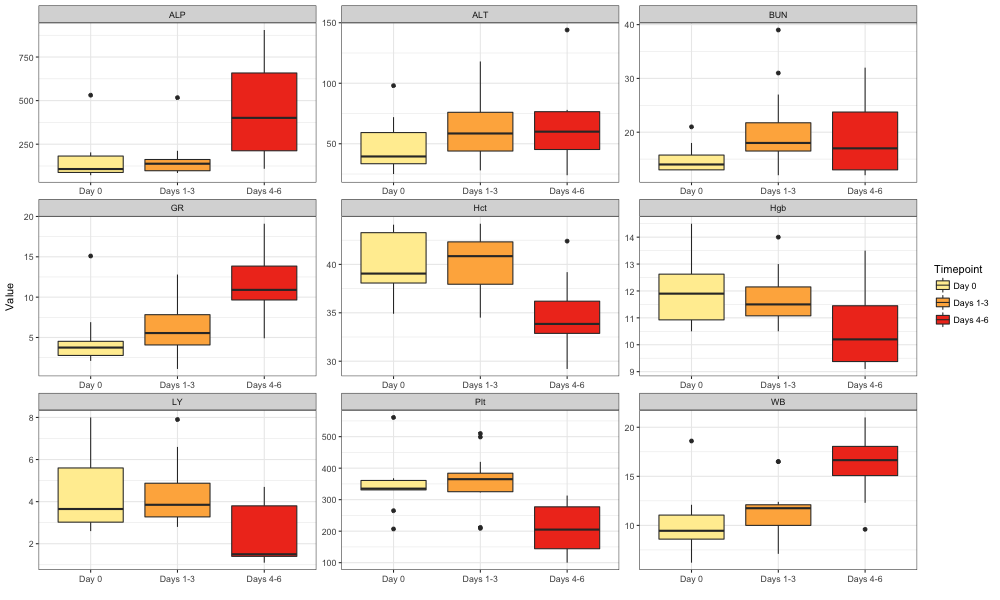

In [12]:
# Get clinical parameters
clinicalParameters = list(set(ebolaParameterEnrichmentDataframe['clinical_parameter']))

# Get timepoint conversion
timepointDict = {0:'Day 0', 1:'Days 1-3', 2:'Days 1-3', 3:'Days 1-3', 4:'Days 4-6', 5:'Days 4-6', 6:'Days 4-6'}

# Group
ebolaAnnotationDataframe['timepoint'] = [timepointDict[x] for x in ebolaAnnotationDataframe['day']]

# Prepare dataframe
ebolaClinicalPlotDataframe = pd.melt(ebolaAnnotationDataframe[['timepoint']+clinicalParameters], id_vars='timepoint')
ebolaClinicalPlotDataframe['value'] = [float(x) for x in ebolaClinicalPlotDataframe['value']]

# Plot
%R -i ebolaClinicalPlotDataframe -h 600 -w 1000 print(ggplot(ebolaClinicalPlotDataframe, aes(x=timepoint, y=value, fill=timepoint)) + geom_boxplot() + facet_wrap(~variable, scale='free') + theme_bw() + scale_fill_manual('Timepoint', values=c('#ffeda0','#feb24c','#f03b20')) + xlab('') + ylab('Value'));

**Figure 7 | Variation of blood parameters across timepoints of viral infection.**  The boxplots display the levels of clinical blood parameters measured across three groups of samples extracted at different timepoints.

#### 1.6.2 Correlation to gene expression
The second section of the analysis aims to investigate the association between clinical blood parameters and gene expression.  To achieve this, the correlation between gene expression levels and blood parameter levels across the 30 RNA-seq samples were measured using Spearman’s index.


In [4]:
plotCytoscapeNetwork(ebolaNetworkFile)

**Figure 8 | Network displaying correlation between gene expression and clinical blood parameter levels.**  Red nodes represent blood parameters, blue nodes represent genes, edges represent correlations and are colored by sign (red indicates positive correlation, blue indicates negative correlation).  Correlations above R=0.6 are displayed.  Note that the geneset shared between GR (granulocytes) and LY (lymphocytes) show opposite correlation signs.


Enrichment results for the top 100 most positively and negatively correlated genes for each parameter are available below:

In [14]:
# Add link
ebolaParameterEnrichmentDataframe['link'] = ['<a href="%(x)s">%(x)s</a>' %locals() for x in ebolaParameterEnrichmentDataframe['URL']]

# Cast
linkDataframe = ebolaParameterEnrichmentDataframe.pivot(index='clinical_parameter', columns='geneset', values='link')

# Display
pd.set_option('display.max_colwidth', -1)
HTML(linkDataframe.to_html(escape=False))

geneset,negatively_correlated,positively_correlated
clinical_parameter,,
ALP,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4d,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4c
ALT,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4f,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4e
BUN,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4h,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4g
GR,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4j,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4i
Hct,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4l,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4k
Hgb,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4n,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4m
LY,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4p,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4o
Plt,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4r,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4q
WB,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4t,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4s


## 2. Yellow Fever
### Overview of the dataset
The Yellow Fever infection dataset consists of 12 microarray samples generated by infection of 3 animals by two virus strains, wild-type Yellow Fever Virus (wtYFV) and 17D-mutated strain, followed by PBMC sampling before infection and at 3 DPI.

While displaying few genetic differences, the two viral strains produce distinctly different disease outcomes in human and monkey hosts.  To investigate the biological effects of the wild-type strain, only samples infected by wtYFV were used in the analysis.

### 1.1 PCA Analysis
To visualize the dataset and assess separation of samples, a PCA analysis was performed on the dataset.


In [15]:
# Add annotation
yfvAnnotationDataframe['annotation'] = ['Viral loads: %(x)s' % locals() for x in yfvAnnotationDataframe['viral_loads']]
plot3DPCA(yfvExpressionDataframe, yfvAnnotationDataframe, 'timepoint', 'annotation', topVarianceGenes=5000, title='PCA Analysis of wtYFV Dataset<br>Colored by Timepoint (DPI)', colors=['#feb24c','#800026'])

**Figure 9 | PCA analysis of the wtYFV microarray dataset.** The plot displays a projection of the gene expression dataset in a 3-dimensional plane, where each point represents a different sample. Axes represent a certain fraction of the variance observed in the dataset, and account for independent sources of variation in the data. Point colors correspond to different timepoints of infection, measured in DPI.  The combination of Principal Components show a discrete separation between samples pre-infection and at day 3 post-infection.


### 1.2 Interactive heatmap
To interactively visualize the dataset, an interactive heatmap was generated using the Clustergrammer tool.


In [16]:
plotClustergrammerWidget(yfvExpressionDataframe, yfvAnnotationDataframe, ['treatment', 'timepoint', 'replicate'], zscore='columns')

Widget Javascript not detected.  It may not be installed or enabled properly.


**Figure 10 | Interactive visualization of the expression of the most variable genes.**  The tool allows to interactively explore the expression of the top 1000 most variably expressed genes (displayed on rows) across the 6 microarray samples (displayed on columns).  Values represent gene expression levels, transformed by Z-scores on columns.  Color bars above the columns show the sample’s treatment type, timepoint of sampling, and replicate number.  The tool allows to identify clusters of coexpressed genes, and to calculate enriched biological terms using Enrichr.

### 1.3 Differential gene expression analysis
Differential gene expression signatures were calculated by comparing gene expression levels at day 3 post infection to the pre-infection levels.  To achieve this, the Characteristic Direction (CD) method was used on normalized expression data.


In [17]:
# Get mean expression
yfvMeanExpressionDataframe = yfvExpressionDataframe.apply(np.mean, 1).to_frame(name='mean_expression')

# Get CD subset
yfvCdDataframeSubset = yfvCdDataframe['YFVwt-infected_day0vYFVwt-infected_day3'].to_frame(name='CD')


# Merge dataframes
yfvMaDataframe = yfvMeanExpressionDataframe.merge(yfvCdDataframeSubset, left_index=True, right_index=True)

# Trace
trace = Scatter(
    x = yfvMaDataframe['mean_expression'],
    y = yfvMaDataframe['CD'],
    mode = 'markers',
    text = yfvMaDataframe.index.tolist())

# Layout
layout = Layout(
    title = 'Differential Expression Results<br>wtYFV infection day 0 vs day 3',
    hovermode = 'closest',
    xaxis = dict(title='Average Expression'),
    yaxis = dict(title='Characteristic Direction<br>')
)

# Plot
fig = dict(data=[trace], layout=layout)
iplot(fig)

**Figure 11 | Summary of the differential expression results for infection of wtYFV.**  The X axis displays mean gene expression, the Y axis displays the differential gene expression signature, points represent genes.  Positive CD values indicate overexpression in infected samples, negative values indicate underexpression.

### 1.4 Enrichment analysis
To investigate the biological pathways associated to the most upregulated and downregulated genes, an enrichment analysis was performed using Enrichr. 



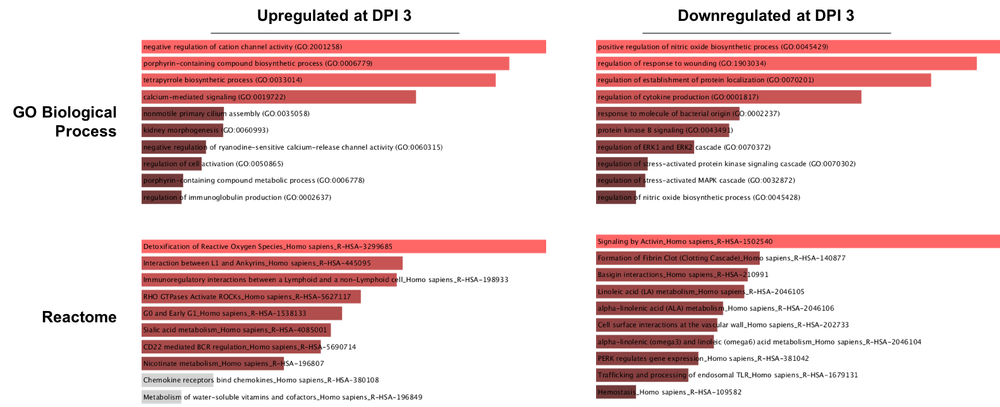

In [26]:
Image('../reports/jupyter-reports/macacus-virus-analysis/yfv_enrichment.png')

**Figure 12 | Selected enrichment results for the top 500 most overexpressed and underexpressed genes induced by wtYFV infection.**  The figure displays some of the terms which are most significantly associated to the genesets, as ranked by Enrichr.

Full enrichment results are available below:

In [19]:
# Get subset
yfvEnrichrLinkDataframeSubset = yfvEnrichrLinkDataframe[yfvEnrichrLinkDataframe['comparison'] == 'YFVwt-infected_day0vYFVwt-infected_day3'].copy()

# Add link
yfvEnrichrLinkDataframeSubset['Results Link'] = ['<a href="%(x)s">%(x)s</a>' % locals() for x in yfvEnrichrLinkDataframeSubset['URL']]

# Add label
yfvEnrichrLinkDataframeSubset['Geneset'] = [x.title() for x in yfvEnrichrLinkDataframeSubset['geneset']]

# Get links
pd.set_option('display.max_colwidth', -1)
HTML(yfvEnrichrLinkDataframeSubset[['Geneset','Results Link']].to_html(escape=False))

,Geneset,Results Link
6,Downregulated,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anx6
7,Upregulated,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1anx5


### 1.5 Small molecule profiling
To identify small molecules which can mimic or reverse the observed differential gene expression signatures when used for treatment on cell lines, the L1000 small molecule perturbation database was queried using the L1000CDS<sup>2</sup> tool.

The top 50 most similar and 50 most opposite signatures were extracted, and the names of the small molecules which generated them were extracted.  Following this, the number of times each small molecule appears within the top 50 signatures was calculated and plotted below.



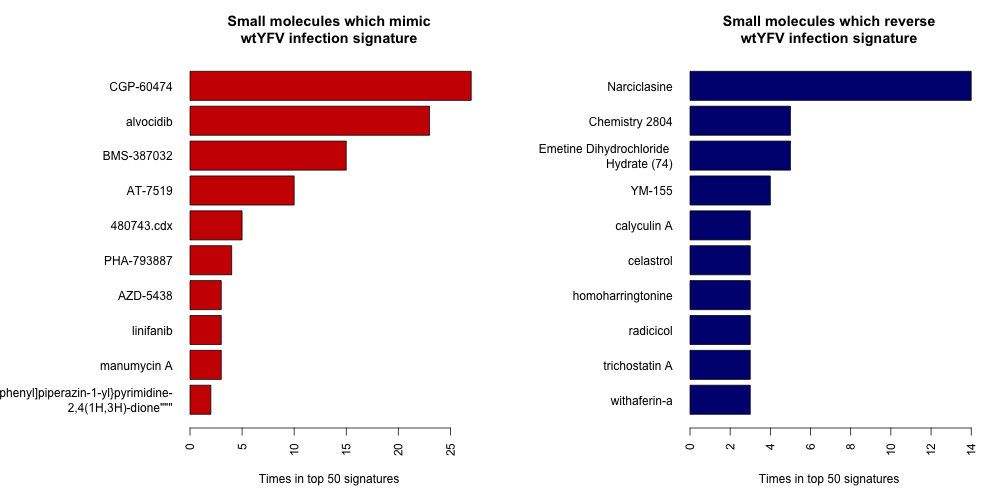

In [20]:
%%R -i yfvDrugSignatureDataframe -h 500 -w 1000
# Set parameters
par(mar=c(5,13,4,2), mfrow=c(1,2))

# Fix names
yfvDrugSignatureDataframe$pert_desc <- gsub('Hydrate', '\nHydrate', yfvDrugSignatureDataframe$pert_desc)
yfvDrugSignatureDataframe$pert_desc <- gsub('2,4', '\n2,4', yfvDrugSignatureDataframe$pert_desc, fixed=TRUE)

# Plot
yfvDrugCounts <- getL1000CDS2Counts(yfvDrugSignatureDataframe, aggravate=TRUE, col='red3', main='Small molecules which mimic\nwtYFV infection signature')
yfvDrugCounts <- getL1000CDS2Counts(yfvDrugSignatureDataframe, aggravate=FALSE, col='navyblue', main='Small molecules which reverse\nwtYFV infection signature')

**Figure 13 | Summary of the most relevant small molecules which mimic or reverse wtYFV infection signature.**  The barchart represents the number of times each molecule appears within the top 50 most similar or opposite signatures.  Some of the small molecules which reverse the signature have been reported to be involved in inhibition of viral replication, such as narciclasine (Gabrielsen et al., 1992) and emetine (Chaves Valadão et al., 2015).

Full results are available below:


In [21]:
# Get subset
yfvDrugLinkDataframe = yfvDrugLinkDataframe[yfvDrugLinkDataframe['comparison'] == 'YFVwt-infected_day0vYFVwt-infected_day3']

# Add link
yfvDrugLinkDataframe['Results Link'] = ['<a href="%(x)s">%(x)s</a>' % locals() for x in yfvDrugLinkDataframe['URL']]

# Add label
yfvDrugLinkDataframe['Direction'] = ['Mimic' if x else 'Reverse' for x in yfvDrugLinkDataframe['aggravate']]

# Get links
pd.set_option('display.max_colwidth', -1)
HTML(yfvDrugLinkDataframe[['Direction','Results Link']].to_html(escape=False))

,Direction,Results Link
6,Mimic,http://amp.pharm.mssm.edu/L1000CDS2/#/result/58b72b1ae467bea600fb6abc
7,Reverse,http://amp.pharm.mssm.edu/L1000CDS2/#/result/58b72b1de467bea600fb6abe


### 1.6 Analysis of clinical data
To explore the impact of wtYFV infection on clinical blood parameters, the variation of their levels across timepoints were investigated.  In order to provide further insight into this relationship, the association between blood parameter levels and gene expression levels was also investigated.

#### 1.6.1 Timepoint analysis
The first section of the analysis aims to investigate the variation of clinical blood parameters across timepoints of viral infection.  Samples were divided in three groups according to time: pre-infection (Day0, n=3) and day 3 post-infection (Day3, n=3).



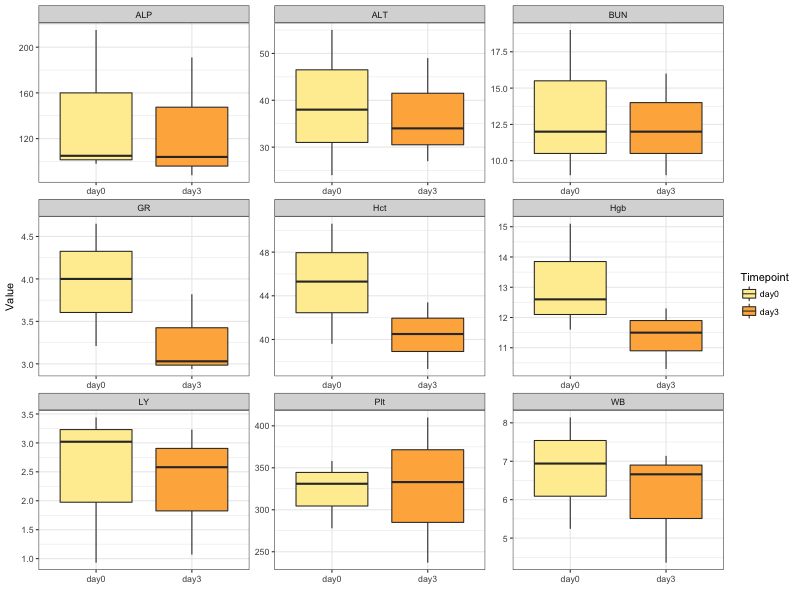

In [22]:
# Get subset of wtYFV
yfvAnnotationDataframeSubset = yfvAnnotationDataframe[yfvAnnotationDataframe['treatment'] == 'YFVwt-infected']

# Get plot dataframe
yfvClinicalPlotDataframe = pd.melt(yfvAnnotationDataframeSubset[['timepoint']+clinicalParameters], id_vars='timepoint')

# Plot
%R -i yfvClinicalPlotDataframe -h 600 -w 800 print(ggplot(yfvClinicalPlotDataframe, aes(x=timepoint, y=value, fill=timepoint)) + geom_boxplot() + facet_wrap(~variable, scale='free') + scale_fill_manual('Timepoint', values=c('#ffeda0','#feb24c')) + xlab('') + ylab('Value') + theme_bw());

**Figure 14 | Variation of blood parameters across timepoints of viral infection.**  The boxplots display the levels of clinical blood parameters measured across two groups of samples extracted at different timepoints.

### 1.6.2 Correlation to gene expression
The second section of the analysis aims to investigate the association between clinical blood parameters and gene expression.  To achieve this, the correlation between gene expression levels and blood parameter levels across the microarray samples were measured using Spearman’s index.



In [5]:
plotCytoscapeNetwork(yfvNetworkFile)

**Figure 15 | Network displaying correlation between gene expression and clinical blood parameter levels.**  Red nodes represent blood parameters, blue nodes represent genes, edges represent correlations and are colored by sign (red indicates positive correlation, blue indicates negative correlation).  Correlations above R=0.7 are displayed.

Enrichment results for the top 100 most positively and negatively correlated genes for each parameter are available below:

In [24]:
# Add link
yfvParameterEnrichmentDataframe['link'] = ['<a href="%(x)s">%(x)s</a>' %locals() for x in yfvParameterEnrichmentDataframe['URL']]

# Cast
linkDataframe = yfvParameterEnrichmentDataframe.pivot(index='clinical_parameter', columns='geneset', values='link')

# Display
pd.set_option('display.max_colwidth', -1)
HTML(linkDataframe.to_html(escape=False))

geneset,negatively_correlated,positively_correlated
clinical_parameter,,
ALP,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4v,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4u
ALT,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4x,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4w
BUN,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4z,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao4y
GR,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao51,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao50
Hct,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao53,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao52
Hgb,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao55,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao54
LY,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao57,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao56
Plt,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao59,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao58
WB,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao5b,http://amp.pharm.mssm.edu/Enrichr/enrich?dataset=1ao5a


# Methods
### Data Preprocessing
#### Ebola Data
FASTQ files containing single-end, 100 base pair reads were generated and kindly provided by Ilhem Messaoudi’s lab.  Kallisto (Bray et al., 2016) was used to align the reads to the latest Ensembl Macaca mulatta transcriptome build (Mmul_8.0.1.cdna.all) and to quantify transcript expression.  Total gene expression was calculated by summing the readcounts of corresponding transcripts.  Raw readcount data was normalized using the Variance Stabilizing Transformation method, from the DESeq2 R package (Love et al., 2014).

#### Yellow Fever Dataset
Raw expression data was downloaded from the GEO series GSE51972.  Probes were matched to gene symbols using the platform annotation file for GPL3535 downloaded from GEO.  Expression levels of genes with multiple matching probes were calculated by averaging the expression of corresponding probes.  Expression data was then normalized using the Quantile Normalization method (Bolstad et al., 2003).

### Data Analysis
#### Principal Components Analysis
An R implementation of the Principal Components Analysis (PCA) algorithm  was used to generate the three-dimensional visualizations of samples.  The analysis was performed by taking a subset of the top 5000 most variables genes in each dataset.

#### Differential expression analysis
Differential gene expression signatures were calculated by applying the Characteristic Direction method (Clark et al., 2014) on normalized gene expression data.  The signatures were generated by comparing samples from each timepoint to the pre-infection timepoint.

#### Enrichment and small molecule identification
Enrichment analysis was performed on the top 500 most overexpressed and underexpressed genesets for each signature using Enrichr (Chen et al., 2013).  Small molecule identification was performed on the complete gene expression signatures using L1000CDS2 (Duan et al., 2016).

#### Clinical data analysis
Associations between clinical parameters and normalized gene expression levels were calculated across each samples by Spearman’s index.  Network visualization was generated with Cytoscape (Shannon et al., 2003).  Displayed networks show the most significant correlations between genes and clinical parameters; a cutoff of 0.6 and 0.7 for Spearman R was used respectively for the Ebola and Yellow Fever datasets.

## References
- Bolstad, B.M., Irizarry, R.A., Astrand, M., and Speed, T.P. (2003). A comparison of normalization methods for high density oligonucleotide array data based on variance and bias. Bioinforma. Oxf. Engl. 19, 185–193.
- Bray, N.L., Pimentel, H., Melsted, P., and Pachter, L. (2016). Near-optimal probabilistic RNA-seq quantification. Nat. Biotechnol. 34, 525–527.
- Chaves Valadão, A.L., Abreu, C.M., Dias, J.Z., Arantes, P., Verli, H., Tanuri, A., and de Aguiar, R.S. (2015). Natural Plant Alkaloid (Emetine) Inhibits HIV-1 Replication by Interfering with Reverse Transcriptase Activity. Mol. Basel Switz. 20, 11474–11489.
- Chen, E.Y., Tan, C.M., Kou, Y., Duan, Q., Wang, Z., Meirelles, G.V., Clark, N.R., and Ma’ayan, A. (2013). Enrichr: interactive and collaborative HTML5 gene list enrichment analysis tool. BMC Bioinformatics 14, 128.
- Clark, N.R., Hu, K.S., Feldmann, A.S., Kou, Y., Chen, E.Y., Duan, Q., and Ma’ayan, A. (2014). The characteristic direction: a geometrical approach to identify differentially expressed genes. BMC Bioinformatics 15, 79.
- Duan, Q., Reid, S.P., Clark, N.R., Wang, Z., Fernandez, N.F., Rouillard, A.D., Readhead, B., Tritsch, S.R., Hodos, R., Hafner, M., et al. (2016). L1000CDS2: LINCS L1000 characteristic direction signatures search engine. Npj Syst. Biol. Appl. 2, 16015.
- Gabrielsen, B., Monath, T.P., Huggins, J.W., Kefauver, D.F., Pettit, G.R., Groszek, G., Hollingshead, M., Kirsi, J.J., Shannon, W.M., and Schubert, E.M. (1992). Antiviral (RNA) activity of selected Amaryllidaceae isoquinoline constituents and synthesis of related substances. J. Nat. Prod. 55, 1569–1581.
- Love, M.I., Huber, W., and Anders, S. (2014). Moderated estimation of fold change and dispersion for RNA-seq data with DESeq2. Genome Biol. 15, 550.
- Mohan, R., Hammers, H., Bargagna-mohan, P., Zhan, X., Herbstritt, C., Ruiz, A., Zhang, L., Hanson, A., Conner, B., Rougas, J., et al. (2004). Withaferin A is a potent inhibitor of angiogenesis. Angiogenesis 7, 115–122.
- Shannon, P., Markiel, A., Ozier, O., Baliga, N.S., Wang, J.T., Ramage, D., Amin, N., Schwikowski, B., and Ideker, T. (2003). Cytoscape: a software environment for integrated models of biomolecular interaction networks. Genome Res. 13, 2498–2504.
